# Importing Lib

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import scipy as sp

import matplotlib.pyplot as plt
# --- plotly ---
from plotly import tools, subplots
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
import plotly.io as pio
#pio.templates.default = "plotly_dark"

## importing Dataset

In [3]:

df1 =pd.read_csv('covid_19_clean_complete.csv')
df_temperature =pd.read_csv('temperature_dataframe_editUS.csv')
df1.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa


## Shape of Dataset

In [4]:
import numpy as np
print(np.shape(df1))
print(np.shape(df_temperature))

(49068, 10)
(16556, 14)


In [5]:
df1.rename(columns={'ObservationDate': 'date', 
                     'Province/State':'state',
                     'Country/Region':'country',
                     'Last Update':'last_updated',
                     'Confirmed': 'confirmed',
                     'Deaths':'deaths',
                     'Recovered':'recovered'
                    }, inplace=True)

# cases 
cases = ['confirmed', 'deaths', 'recovered', 'active']

# Active Case = confirmed - deaths - recovered
df1['active'] = df1['confirmed'] - df1['deaths'] - df1['recovered']

# replacing Mainland china with just China
df1['country'] = df1['country'].replace('Mainland China', 'China')

# filling missing values 
df1[['state']] = df1[['state']].fillna('')
df1[cases] = df1[cases].fillna(0)
df1.rename(columns={'Date':'date'}, inplace=True)

data = df1

display(data.head())
display(data.info())

,state,country,Lat,Long,date,confirmed,deaths,recovered,Active,WHO Region,active
0,,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,0
1,,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe,0
2,,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa,0
3,,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe,0
4,,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 11 columns):
state         49068 non-null object
country       49068 non-null object
Lat           49068 non-null float64
Long          49068 non-null float64
date          49068 non-null object
confirmed     49068 non-null int64
deaths        49068 non-null int64
recovered     49068 non-null int64
Active        49068 non-null int64
WHO Region    49068 non-null object
active        49068 non-null int64
dtypes: float64(2), int64(5), object(4)
memory usage: 4.1+ MB


None

 
## 1. Convert urban percentage to float
## 2. Convert Age to integer
## 3. Convert Fertility Rate to float
## 4. Rename some country    

In [6]:
def p2f(x):
    """
    Convert urban percentage to float
    """
    try:
        return float(x.strip('%'))/100
    except:
        return np.nan

def age2int(x):
    """
    Convert Age to integer
    """
    try:
        return int(x)
    except:
        return np.nan

def fert2float(x):
    """
    Convert Fertility Rate to float
    """
    try:
        return float(x)
    except:
        return np.nan


countries_df = pd.read_csv("population_by_country_2020.csv", converters={'Urban Pop %':p2f,
                                                                                                             'Fert. Rate':fert2float,
                                                                                                             'Med. Age':age2int})
countries_df.rename(columns={'Country (or dependency)': 'country',
                             'Population (2020)' : 'population',
                             'Density (P/Km²)' : 'density',
                             'Fert. Rate' : 'fertility',
                             'Med. Age' : "age",
                             'Urban Pop %' : 'urban_percentage'}, inplace=True)



countries_df['country'] = countries_df['country'].replace('United States', 'US')
countries_df = countries_df[["country", "population", "density", "fertility", "age", "urban_percentage"]]

countries_df.head()

,country,population,density,fertility,age,urban_percentage
0,China,1440297825,153,1.7,38.0,0.61
1,India,1382345085,464,2.2,28.0,0.35
2,US,331341050,36,1.8,38.0,0.83
3,Indonesia,274021604,151,2.3,30.0,0.56
4,Pakistan,221612785,287,3.6,23.0,0.35


In [7]:
data = pd.merge(data, countries_df, on='country')

In [8]:
data.sample(5)

,state,country,Lat,Long,date,confirmed,deaths,recovered,Active,WHO Region,active,population,density,fertility,age,urban_percentage
36385,,Slovakia,48.669000,19.69900,2020-05-02,1407,24,608,775,Europe,775,5460109,114,1.5,41.0,0.54
23000,,Guyana,4.860416,-58.93018,2020-03-26,5,1,0,4,Americas,4,787215,4,2.5,27.0,0.27
21607,,Gabon,-0.803700,11.60940,2020-07-15,6121,46,3664,2411,Africa,2411,2234448,9,4.0,23.0,0.87
43459,,Grenada,12.116500,-61.67900,2020-02-22,0,0,0,0,Americas,0,112614,331,2.1,32.0,0.35
11445,Zhejiang,China,29.183200,120.09340,2020-03-23,1238,1,1221,16,Western Pacific,16,1440297825,153,1.7,38.0,0.61


## Weather Dataset

In [9]:
df_temperature.head()

,0,1,Unnamed: 2,Afghanistan,33,65,"22,01,20",0.1,0.2,Kabul,65.1,8.7,-1,8
0,1,2,NaN,Afghanistan,33.0,65.0,"23,01,20",0,0,Kabul,59.0,8.7,-3.0,8.0
1,2,3,NaN,Afghanistan,33.0,65.0,"24,01,20",0,0,Kabul,71.0,7.1,0.0,7.0
2,3,4,NaN,Afghanistan,33.0,65.0,"25,01,20",0,0,Kabul,79.0,8.7,0.0,7.0
3,4,5,NaN,Afghanistan,33.0,65.0,"26,01,20",0,0,Kabul,64.0,8.7,-1.0,8.0
4,5,6,NaN,Afghanistan,33.0,65.0,"27,01,20",0,0,Kabul,66.0,8.7,-1.0,6.0


# Giving Appropeiate column name

In [10]:
df_temperature.columns = ["#","id","province","country","lat","long","date","case","fatalities","capital","humidity","sunHour","tempC","windspeedKmph"]

df_temperature['country'] = df_temperature['country'].replace('USA', 'US')
df_temperature['country'] = df_temperature['country'].replace('UK', 'United Kingdom')
df_temperature = df_temperature[["country", "province", "date", "humidity", "sunHour", "tempC", "windspeedKmph"]].reset_index()
df_temperature.rename(columns={'province': 'state'}, inplace=True)
df_temperature["date"] = pd.to_datetime(df_temperature['date'], format ="%d,%m,%y").astype(np.str)

df_temperature['state'] = df_temperature['state'].fillna('')
df_temperature.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16556 entries, 0 to 16555
Data columns (total 8 columns):
index            16556 non-null int64
country          16556 non-null object
state            16556 non-null object
date             16556 non-null object
humidity         16379 non-null float64
sunHour          16379 non-null float64
tempC            16379 non-null float64
windspeedKmph    16379 non-null float64
dtypes: float64(4), int64(1), object(3)
memory usage: 1.0+ MB


In [11]:
df_temperature.head()

,index,country,state,date,humidity,sunHour,tempC,windspeedKmph
0,0,Afghanistan,,2020-01-23,59.0,8.7,-3.0,8.0
1,1,Afghanistan,,2020-01-24,71.0,7.1,0.0,7.0
2,2,Afghanistan,,2020-01-25,79.0,8.7,0.0,7.0
3,3,Afghanistan,,2020-01-26,64.0,8.7,-1.0,8.0
4,4,Afghanistan,,2020-01-27,66.0,8.7,-1.0,6.0


## merge both the dataset for further compare

In [12]:

data = data.merge(df_temperature, on=['country','date', 'state'], how='outer')
data['mortality_rate'] = data['deaths'] / data['confirmed']

In [13]:
data.sample(5)

,state,country,Lat,Long,date,confirmed,deaths,recovered,Active,WHO Region,...,density,fertility,age,urban_percentage,index,humidity,sunHour,tempC,windspeedKmph,mortality_rate
33491,,Paraguay,-23.4425,-58.4438,2020-06-25,1569.0,13.0,976.0,580.0,Americas,...,18.0,2.4,26.0,0.62,NaN,NaN,NaN,NaN,NaN,0.008286
28742,,Malta,35.9375,14.3754,2020-05-07,486.0,5.0,413.0,68.0,Europe,...,1380.0,1.5,43.0,0.93,NaN,NaN,NaN,NaN,NaN,0.010288
40876,Gibraltar,United Kingdom,36.1408,-5.3536,2020-04-18,132.0,0.0,111.0,21.0,Europe,...,281.0,1.8,40.0,0.83,NaN,NaN,NaN,NaN,NaN,0.000000
10451,Tianjin,China,39.3054,117.3230,2020-02-22,135.0,3.0,65.0,67.0,Western Pacific,...,153.0,1.7,38.0,0.61,3870.0,22.0,8.7,11.0,13.0,0.022222
19562,French Guiana,France,3.9339,-53.1258,2020-02-09,0.0,0.0,0.0,0.0,Europe,...,119.0,1.9,42.0,0.82,5963.0,78.0,5.0,12.0,31.0,NaN


In [14]:
data.describe()

,Lat,Long,confirmed,deaths,recovered,Active,active,population,density,fertility,age,urban_percentage,index,humidity,sunHour,tempC,windspeedKmph,mortality_rate
count,47060.000000,47060.000000,4.706000e+04,47060.000000,4.706000e+04,4.706000e+04,4.706000e+04,4.706000e+04,47060.000000,45744.000000,45744.000000,46120.000000,16556.000000,16379.000000,16379.000000,16379.000000,16379.000000,37498.000000
mean,21.551301,23.701088,1.754419e+04,920.616447,8.224040e+03,8.399538e+03,8.399538e+03,2.221878e+08,302.083468,2.393529,33.198146,0.640180,8277.500000,66.443678,8.530521,16.045607,12.632212,0.028395
std,25.224665,71.082998,1.299454e+05,6444.342587,5.593594e+04,7.785278e+04,7.785278e+04,4.841137e+08,1748.249732,1.152287,8.616654,0.205517,4779.449864,19.014447,2.525988,10.610625,7.675565,0.044522
min,-51.796300,-135.000000,0.000000e+00,0.000000,0.000000e+00,-1.400000e+01,-1.400000e+01,8.010000e+02,0.000000,1.100000,15.000000,0.130000,0.000000,5.000000,1.500000,-21.000000,1.000000,0.000000
25%,7.946500,-19.020800,4.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,4.947267e+06,32.000000,1.700000,26.000000,0.530000,4138.750000,56.000000,6.200000,9.000000,7.000000,0.000000
50%,23.685000,21.824300,1.680000e+02,2.000000,3.000000e+01,2.600000e+01,2.600000e+01,1.921461e+07,108.000000,1.800000,38.000000,0.630000,8277.500000,72.000000,8.700000,14.000000,11.000000,0.013629
75%,41.295600,84.250000,1.555000e+03,32.000000,6.982500e+02,6.210000e+02,6.210000e+02,6.529893e+07,153.000000,2.800000,40.000000,0.820000,12416.250000,80.000000,11.000000,25.000000,16.000000,0.039474
max,71.706900,178.065000,4.290259e+06,148011.000000,1.846641e+06,2.816444e+06,2.816444e+06,1.440298e+09,26337.000000,7.000000,48.000000,0.980000,16555.000000,99.000000,14.000000,45.000000,71.000000,1.000000


In [15]:
data.columns

Index(['state', 'country', 'Lat', 'Long', 'date', 'confirmed', 'deaths',
       'recovered', 'Active', 'WHO Region', 'active', 'population', 'density',
       'fertility', 'age', 'urban_percentage', 'index', 'humidity', 'sunHour',
       'tempC', 'windspeedKmph', 'mortality_rate'],
      dtype='object')

# Drawing correlation among Weather and covid variables

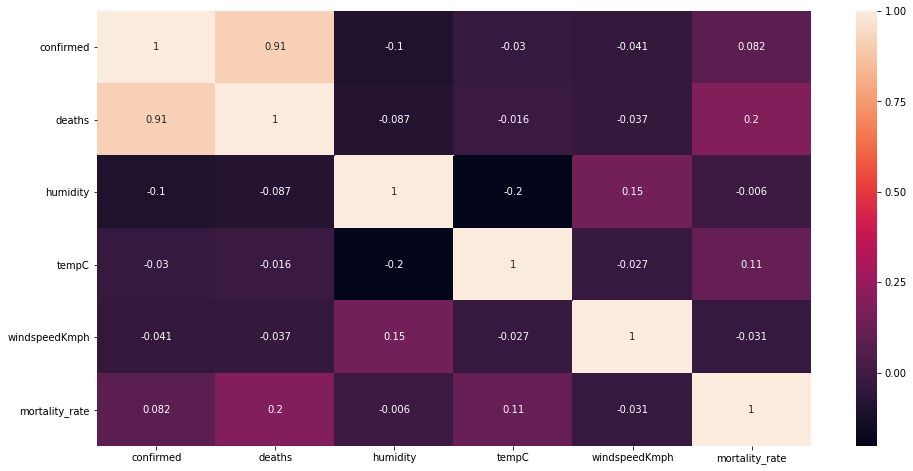

In [16]:
df =data[['confirmed','deaths','humidity','tempC', 'windspeedKmph', 'mortality_rate']]
cor =df.corr()
plt.figure(figsize = (16,8))
sns.heatmap(cor,annot = True)

# temprature analysis

In [17]:
temp_gdf = data.groupby(['date', 'country'])['tempC', 'humidity'].mean()
temp_gdf = temp_gdf.reset_index()
temp_gdf['date'] = pd.to_datetime(temp_gdf['date'])
temp_gdf['date'] = temp_gdf['date'].dt.strftime('%m/%d/%Y')

temp_gdf['tempC_pos'] = temp_gdf['tempC'] - temp_gdf['tempC'].min()  # To use it with size

wind_gdf = data.groupby(['date', 'country'])['windspeedKmph'].max()
wind_gdf = wind_gdf.reset_index()
wind_gdf['date'] = pd.to_datetime(temp_gdf['date'])
wind_gdf['date'] = wind_gdf['date'].dt.strftime('%m/%d/%Y')

In [18]:
target_gdf = data.groupby(['date', 'country'])['confirmed', 'deaths'].sum()
target_gdf = target_gdf.reset_index()
target_gdf['date'] = pd.to_datetime(target_gdf['date'])
target_gdf['date'] = target_gdf['date'].dt.strftime('%m/%d/%Y')

In [19]:
from IPython.core.display import display, HTML
from tqdm.notebook import tqdm

In [20]:
gdf = pd.merge(target_gdf, temp_gdf, on=['date', 'country'])
gdf['confirmed_log1p'] = np.log1p(gdf['confirmed'])
gdf['deaths_log1p'] = np.log1p(gdf['deaths'])
gdf['mortality_rate'] = gdf['deaths'] / gdf['confirmed']

gdf = pd.merge(gdf, wind_gdf, on=['date', 'country'])

In [21]:
fig = px.scatter_geo(gdf.fillna(0), locations="country", locationmode='country names', 
                     color="tempC", size='confirmed_log1p', hover_name="country", 
                     range_color= [-20, 45], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: log1p(confirmed) VS Temperature by country', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

In [22]:
fig = px.scatter_geo(gdf.fillna(0), locations="country", locationmode='country names', 
                     color="tempC", size='deaths', hover_name="country", 
                     range_color= [-20, 45], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: deaths VS temperature by country', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

In [23]:
fig = px.scatter_geo(gdf.fillna(0), locations="country", locationmode='country names', 
                     color="tempC", size='mortality_rate', hover_name="country", 
                     range_color= [-20, 45], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Mortality rate VS Temperature by country', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

In [24]:
fig = px.scatter_geo(gdf.fillna(0), locations="country", locationmode='country names', 
                     color="humidity", size='confirmed_log1p', hover_name="country", 
                     range_color= [0, 100], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: log1p(confirmed) VS Humidity by country', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

In [25]:
fig = px.scatter_geo(gdf.fillna(0), locations="country", locationmode='country names', 
                     color="windspeedKmph", size='confirmed_log1p', hover_name="country", 
                     range_color= [0, 40], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: log1p(Confirmed) VS Wind speed by country', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

# Regression Model
By implementing a regression model which tries to use the country input variables to predict the most recent number of infections and deaths as target, we can extract the relative feature importance. This can be done pretty well with a Random Forest Regressor.

In [26]:
train_data = data
print(train_data.shape)
train_data.head()

(52039, 22)


,state,country,Lat,Long,date,confirmed,deaths,recovered,Active,WHO Region,...,density,fertility,age,urban_percentage,index,humidity,sunHour,tempC,windspeedKmph,mortality_rate
0,,Afghanistan,33.93911,67.709953,2020-01-22,0.0,0.0,0.0,0.0,Eastern Mediterranean,...,60.0,4.6,18.0,0.25,NaN,NaN,NaN,NaN,NaN,NaN
1,,Afghanistan,33.93911,67.709953,2020-01-23,0.0,0.0,0.0,0.0,Eastern Mediterranean,...,60.0,4.6,18.0,0.25,0.0,59.0,8.7,-3.0,8.0,NaN
2,,Afghanistan,33.93911,67.709953,2020-01-24,0.0,0.0,0.0,0.0,Eastern Mediterranean,...,60.0,4.6,18.0,0.25,1.0,71.0,7.1,0.0,7.0,NaN
3,,Afghanistan,33.93911,67.709953,2020-01-25,0.0,0.0,0.0,0.0,Eastern Mediterranean,...,60.0,4.6,18.0,0.25,2.0,79.0,8.7,0.0,7.0,NaN
4,,Afghanistan,33.93911,67.709953,2020-01-26,0.0,0.0,0.0,0.0,Eastern Mediterranean,...,60.0,4.6,18.0,0.25,3.0,64.0,8.7,-1.0,8.0,NaN


(We only wish to have a look at countries which already have an infection ratio higher than 0, because the ones that aren't infected yet, might bias the feature importance)

In [27]:
threshold = 0
train_data['infectionRate'] = round((train_data['confirmed']/train_data['population'])*100, 5)
train_data = train_data[train_data['infectionRate'] >= threshold]
print(train_data.shape)

(47060, 23)


In [28]:


train_data = train_data.drop([
                     "country", 
                      'active',
                      'Active',
                     "recovered", 
                     "infectionRate",
                     "state",
                     "Lat",
                     "Long",
                     "date",
                     'index',
                     "WHO Region",
                     'mortality_rate'
                    
    
                    ], axis= 1).dropna()

y = train_data[["confirmed", "deaths"]]
X = train_data.drop(["confirmed", "deaths"],axis=1)

display(X.sample(5))
print(X.shape, y.shape)

,population,density,fertility,age,urban_percentage,humidity,sunHour,tempC,windspeedKmph
4909,1.170021e+07,11.0,2.8,26.0,0.69,75.0,8.9,21.0,10.0
7043,3.779941e+07,4.0,1.5,41.0,0.81,91.0,5.5,-9.0,13.0
9461,1.440298e+09,153.0,1.7,38.0,0.61,44.0,8.7,7.0,7.0
36385,5.460109e+06,114.0,1.5,41.0,0.54,80.0,4.2,9.0,20.0
26021,1.881523e+07,7.0,2.8,31.0,0.58,89.0,4.9,3.0,32.0


(11099, 9) (11099, 2)


In [29]:
train_data.columns

Index(['confirmed', 'deaths', 'population', 'density', 'fertility', 'age',
       'urban_percentage', 'humidity', 'sunHour', 'tempC', 'windspeedKmph'],
      dtype='object')

In [30]:
from sklearn.model_selection import train_test_split as tts
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import Lasso
from sklearn.tree import DecisionTreeRegressor

from sklearn.metrics import mean_squared_log_error, make_scorer
def rmsle(y_true, y_pred):
    
    return np.sqrt(mean_squared_log_error(y_true, y_pred))

rmsle_scorer = make_scorer(rmsle)

X_train, X_val, y_train, y_val = tts(X, y, test_size= 0.2, random_state=42, shuffle=True)

In [31]:
model_infected = DecisionTreeRegressor(random_state=42, criterion="mae")

scores = cross_val_score(model_infected, 
                      X_train,
                      y_train["confirmed"],
                      cv=5, scoring=rmsle_scorer)

print("Cross Validation of Confirmed Cases: Mean = {}, std = {}".format(scores.mean(), scores.std()))
model_infected.fit(X_train, y_train["confirmed"])
result_infected = rmsle(y_val["confirmed"], model_infected.predict(X_val))
print("Validation Infected set RMSLE: {}".format(result_infected))

Cross Validation of Confirmed Cases: Mean = 1.665056348509306, std = 0.11026815387618191
Validation Infected set RMSLE: 1.6332646139342741


In [32]:
model_deaths = DecisionTreeRegressor(random_state=42, criterion="mae")

scores = cross_val_score(model_deaths, 
                      X_train,
                      y_train["deaths"],
                      cv=5, scoring=rmsle_scorer)

print("Cross Validation of Fatal Cases: Mean = {}, std = {}".format(scores.mean(), scores.std()))
model_deaths.fit(X_train, y_train["deaths"])
result_deaths = rmsle(y_val["deaths"], model_deaths.predict(X_val))
print("Validation Death set RMSLE: {}".format(result_deaths))

Cross Validation of Fatal Cases: Mean = 0.7580731089224712, std = 0.03176444150330569
Validation Death set RMSLE: 0.7112685174101263


In [33]:
# Final Evalutation
print("Final Validatio score: {}".format(np.mean([result_infected, result_deaths])))

Final Validatio score: 1.1722665656722002


# Extract Features for Infections

In [34]:
model_infected = model_infected.fit(X, y["confirmed"])
model_deaths = model_deaths.fit(X, y["deaths"])

In [35]:
def show_feature_importance(forest):

    importances = forest.feature_importances_
    indices = np.argsort(importances)[::-1]

    # Print the feature ranking
    print("Feature ranking:")

    for f in range(X.shape[1]):
        print("{}, Feature: {}, Importance: {}".format(f + 1, X.columns[indices[f]], importances[indices[f]]))

    # Plot the feature importances of the forest
    plt.figure(figsize=(20,10))
    plt.title("Feature importances")
    plt.bar(range(X.shape[1]), importances[indices], color="b", align="center")
    plt.xticks(range(X.shape[1]),  X.columns[indices], rotation='vertical')
    plt.xlim([-1, X.shape[1]])
    plt.show()

Feature ranking:
1, Feature: tempC, Importance: 0.2570790052197829
2, Feature: sunHour, Importance: 0.25045373563517775
3, Feature: humidity, Importance: 0.2058261530927998
4, Feature: population, Importance: 0.13502776591200336
5, Feature: windspeedKmph, Importance: 0.1296412831706275
6, Feature: density, Importance: 0.015430137214657047
7, Feature: age, Importance: 0.004753024036007128
8, Feature: urban_percentage, Importance: 0.0014065283754076364
9, Feature: fertility, Importance: 0.0003823673435367415


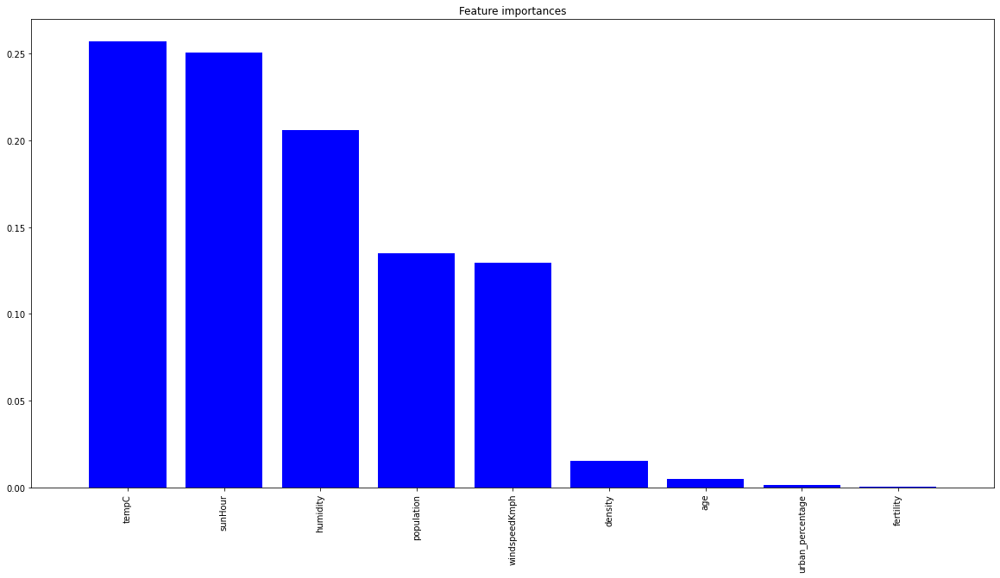

In [36]:
show_feature_importance(model_infected)

Feature ranking:
1, Feature: tempC, Importance: 0.2783188108662247
2, Feature: sunHour, Importance: 0.23116350589441223
3, Feature: population, Importance: 0.2234751409533564
4, Feature: humidity, Importance: 0.12045105074320783
5, Feature: windspeedKmph, Importance: 0.10199897488467109
6, Feature: density, Importance: 0.024602767811378688
7, Feature: age, Importance: 0.01230138390568934
8, Feature: urban_percentage, Importance: 0.004100461301900208
9, Feature: fertility, Importance: 0.0035879036391593903


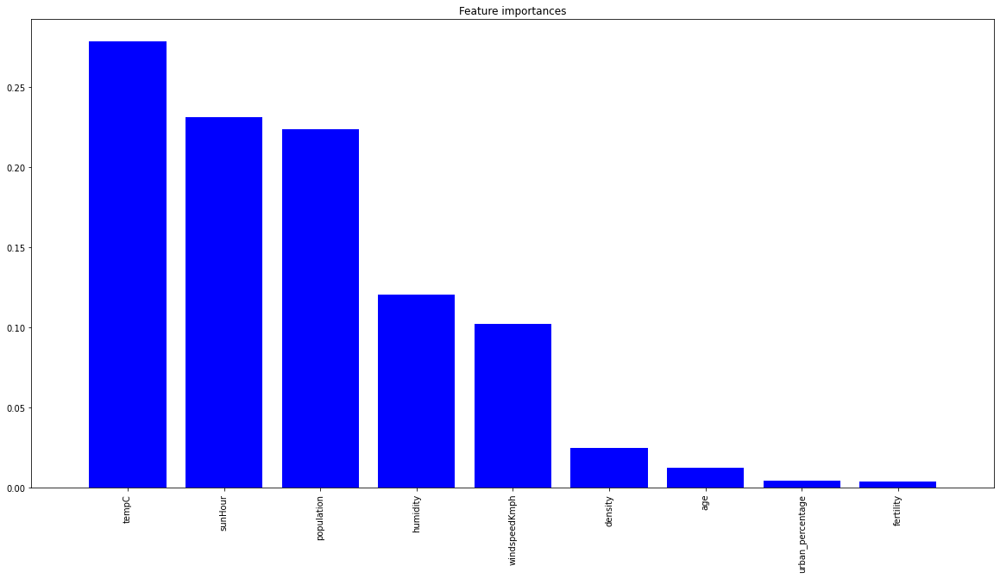

In [37]:
show_feature_importance(model_deaths)

In [38]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error

In [39]:
model=xgb.XGBRegressor()


In [40]:

model.fit(X_train, y_train["confirmed"])
result_infected = model.predict(X_val)


rmse = np.sqrt(mean_squared_error(y_val["confirmed"], result_infected))
print("RMSE: %f" % (rmse))


RMSE: 3896.523989


In [41]:
model.fit(X_train, y_train["deaths"])
result_infected = model.predict(X_val)


rmse = np.sqrt(mean_squared_error(y_val["deaths"], result_infected))
print("RMSE: %f" % (rmse))

RMSE: 168.723082


In [42]:
model1 = model.fit(X, y["confirmed"])

In [43]:
model2 = model.fit(X, y["deaths"])

Feature ranking:
1, Feature: tempC, Importance: 0.35495057702064514
2, Feature: age, Importance: 0.21332119405269623
3, Feature: population, Importance: 0.14023077487945557
4, Feature: humidity, Importance: 0.13851499557495117
5, Feature: sunHour, Importance: 0.0608714334666729
6, Feature: windspeedKmph, Importance: 0.05045246332883835
7, Feature: fertility, Importance: 0.030685920268297195
8, Feature: urban_percentage, Importance: 0.0058647445403039455
9, Feature: density, Importance: 0.005107935518026352


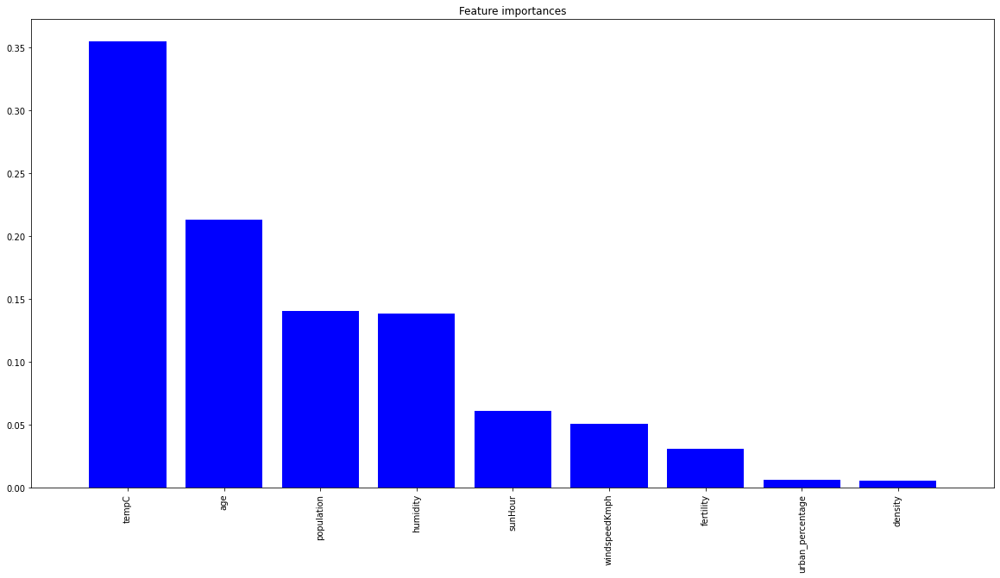

In [44]:
show_feature_importance(model1)

Feature ranking:
1, Feature: tempC, Importance: 0.35495057702064514
2, Feature: age, Importance: 0.21332119405269623
3, Feature: population, Importance: 0.14023077487945557
4, Feature: humidity, Importance: 0.13851499557495117
5, Feature: sunHour, Importance: 0.0608714334666729
6, Feature: windspeedKmph, Importance: 0.05045246332883835
7, Feature: fertility, Importance: 0.030685920268297195
8, Feature: urban_percentage, Importance: 0.0058647445403039455
9, Feature: density, Importance: 0.005107935518026352


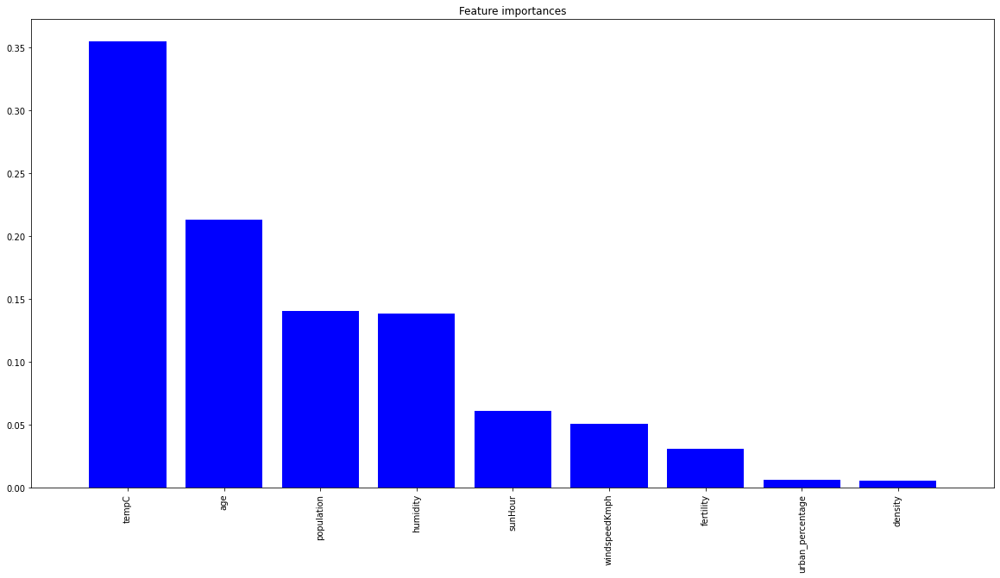

In [45]:
show_feature_importance(model2)

# Thank you